In [ ]:
!pip -q install plyfile lpips==0.1.4 imageio matplotlib tqdm
!pip -q install scikit-learn

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

import os, math, json, pathlib, time, random, shutil
import numpy as np
import torch
import torch.nn.functional as F
import torchvision
import matplotlib.pyplot as plt
import imageio
from PIL import Image
from plyfile import PlyData
from tqdm import tqdm

SCENE_PLY = "/content/drive/MyDrive/gaussplat_output/gs_lego_perfect/point_cloud/iteration_80000/point_cloud.ply"
OUTPUT_DIR = "/content/PruneAndProve_results"
os.makedirs(OUTPUT_DIR, exist_ok=True)

assert os.path.exists(SCENE_PLY), "Place your point_cloud.ply at the SCENE_PLY path."
print("OK")

Mounted at /content/drive
OK


In [ ]:
!pip install open3d -q
import open3d as o3d
import numpy as np

pcd = o3d.io.read_point_cloud(SCENE_PLY)
print(pcd)
print("Number of points:", np.asarray(pcd.points).shape[0])
o3d.visualization.draw_geometries([pcd])

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 447.7/447.7 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 77.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 62.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 48.3 MB/s eta 0:00:00
PointCloud with 385742 points.
Number of points: 385742
[Open3D WARNING] GLFW Error: Failed to detect any supported platform
[Open3D WARNING] GLFW initialized for headless rendering.
[Open3D WARNING] GLFW Error: OSMesa: Library not found
[Open3D WARNING] Failed to create window
[Open3D WARNING] [DrawGeometries] Failed creating OpenGL window.


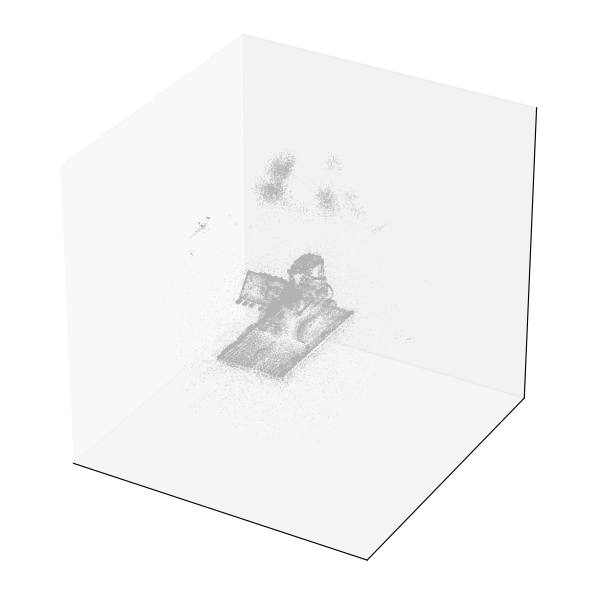

Saved preview to: /content/PruneAndProve_results/pointcloud_preview.png


In [ ]:
pts = np.asarray(pcd.points)
cols = np.asarray(pcd.colors) if len(pcd.colors) == len(pts) else None
idx = np.random.choice(len(pts), size=min(80000, len(pts)), replace=False)
p = pts[idx]
c = cols[idx] if cols is not None else np.full((len(idx),3), 0.7)

mx = p.max(0); mn = p.min(0); ctr = (mx+mn)/2.0; scale = (mx-mn).max()
p_n = (p-ctr)/max(scale, 1e-6)

fig = plt.figure(figsize=(6,6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(p_n[:,0], p_n[:,1], p_n[:,2], c=c, s=0.2, linewidth=0)
ax.set_xticks([]); ax.set_yticks([]); ax.set_zticks([])
ax.set_box_aspect([1,1,1])
plt.tight_layout()
png_path = os.path.join(OUTPUT_DIR, "pointcloud_preview.png")
plt.savefig(png_path, dpi=300)
plt.show()

print("Saved preview to:", png_path)

In [ ]:
import plotly.graph_objects as go

ply = PlyData.read(SCENE_PLY)
v = ply['vertex'].data
x = np.stack([v['x'], v['y'], v['z']], axis=1)

def get_field(name):
    return v[name] if name in v.dtype.names else None

r = get_field('f_dc_0'); g = get_field('f_dc_1'); b = get_field('f_dc_2')
if r is not None and g is not None and b is not None:
    rgb = np.stack([r, g, b], axis=1)
    rgb = 1/(1+np.exp(-rgb))
else:
    red = get_field('red'); green = get_field('green'); blue = get_field('blue')
    if red is not None and green is not None and blue is not None:
        rgb = np.stack([red, green, blue], axis=1).astype(np.float32) / 255.0
    else:
        rgb = np.full((x.shape[0],3), 0.7, dtype=np.float32)

idx = np.random.choice(x.shape[0], size=min(150000, x.shape[0]), replace=False)
px = x[idx]; pc = rgb[idx]

fig = go.Figure(
    data=[go.Scatter3d(x=px[:,0], y=px[:,1], z=px[:,2],
                       mode='markers',
                       marker=dict(size=1, color=pc, opacity=0.85))]
)
fig.update_layout(scene=dict(xaxis=dict(visible=False),
                             yaxis=dict(visible=False),
                             zaxis=dict(visible=False)),
                  margin=dict(l=0,r=0,b=0,t=0))
fig.show()

In [ ]:
ply = PlyData.read(SCENE_PLY)
v = ply['vertex'].data
names = v.dtype.names

def col(prefix, k): return np.stack([v[f"{prefix}_{i}"] for i in range(k)], 1).astype(np.float32)
def has(prefix, k): return all(f"{prefix}_{i}" in names for i in range(k))

xyz = np.stack([v['x'], v['y'], v['z']], 1).astype(np.float32)

if has('f_dc',3):
    f_dc = col('f_dc',3)
else:
    if all(n in names for n in ['red','green','blue']):
        f_dc = np.stack([v['red'],v['green'],v['blue']],1).astype(np.float32)/255.0
    else:
        f_dc = np.full((xyz.shape[0],3),0.5,dtype=np.float32)

f_rest = None
for L in [45,48,63]:
    if has('f_rest',L):
        f_rest = col('f_rest',L); break

scales = col('scale',3) if has('scale',3) else np.ones((xyz.shape[0],3),dtype=np.float32)
rot = col('rot',4) if has('rot',4) else (col('rotation',4) if has('rotation',4) else np.tile(np.array([0,0,0,1],np.float32),(xyz.shape[0],1)))
opacity = v['opacity'].astype(np.float32) if 'opacity' in names else np.ones((xyz.shape[0],),dtype=np.float32)

data = {
    'xyz': torch.from_numpy(xyz),
    'f_dc': torch.from_numpy(f_dc),
    'f_rest': None if f_rest is None else torch.from_numpy(f_rest),
    'scales': torch.from_numpy(scales),
    'rot': torch.from_numpy(rot),
    'opacity': torch.from_numpy(opacity)
}

np.savez_compressed(os.path.join(OUTPUT_DIR,"scene_tensors.npz"),
                    xyz=xyz,f_dc=f_dc,f_rest=(f_rest if f_rest is not None else np.array([])),
                    scales=scales,rot=rot,opacity=opacity)
print({k: tuple(v.shape) if hasattr(v,'shape') else None for k,v in data.items()})

{'xyz': (385742, 3), 'f_dc': (385742, 3), 'f_rest': (385742, 45), 'scales': (385742, 3), 'rot': (385742, 4), 'opacity': (385742,)}


In [ ]:
H, W = 480, 640
fx = fy = 800.0
cx, cy = W/2.0, H/2.0

def look_at(eye, target, up):
    f = (target - eye); f = f / (np.linalg.norm(f) + 1e-8)
    u0 = up / (np.linalg.norm(up) + 1e-8)
    s = np.cross(f, u0); s = s / (np.linalg.norm(s) + 1e-8)
    u = np.cross(s, f)
    R = np.stack([s, u, f], axis=0).astype(np.float32)
    t = (-R @ eye.astype(np.float32))
    return R, t

def circle_poses(center, radius=2.0, height=0.0, n=12):
    poses = []
    for i in range(n):
        a = 2*np.pi*i/n
        eye = center + np.array([radius*np.cos(a), height, radius*np.sin(a)], dtype=np.float32)
        R, t = look_at(eye, center, np.array([0,1,0], dtype=np.float32))
        poses.append((R, t))
    return poses

ctr = data['xyz'].numpy().mean(axis=0).astype(np.float32)
bbox = data['xyz'].numpy().max(0) - data['xyz'].numpy().min(0)
rad = float(np.linalg.norm(bbox)) * 0.6
poses = circle_poses(ctr, radius=max(rad, 1e-3), height=0.0, n=12)

K = np.array([[fx,0,cx],[0,fy,cy],[0,0,1]], dtype=np.float32)
print("poses:", len(poses))

poses: 12


In [ ]:
def render_points(R, t, K, H, W, data):
    xyz = data['xyz'].cpu().numpy() if isinstance(data['xyz'], torch.Tensor) else data['xyz']
    fdc = data['f_dc'].cpu().numpy() if isinstance(data['f_dc'], torch.Tensor) else data['f_dc']
    if xyz.size == 0: return np.zeros((H,W,3), np.float32)
    rgb = 1.0/(1.0+np.exp(-fdc))
    X = xyz @ R.T + t
    z = X[:,2]; m = z>1e-6
    if m.sum()==0: return np.zeros((H,W,3), np.float32)
    X = X[m]; rgb = rgb[m]; z = z[m]
    x = X[:,0]/z; y = X[:,1]/z
    fx,fy,cx,cy = K[0,0],K[1,1],K[0,2],K[1,2]
    u = np.round(fx*x+cx).astype(np.int32)
    v = np.round(fy*y+cy).astype(np.int32)
    m2 = (u>=0)&(u<W)&(v>=0)&(v<H)
    if m2.sum()==0: return np.zeros((H,W,3), np.float32)
    u=u[m2]; v=v[m2]; rgb=rgb[m2]
    g = np.array([0.06136,0.24477,0.38774,0.24477,0.06136], np.float32)
    K2 = np.outer(g,g).astype(np.float32)
    offs = [(di,dj,K2[di+2,dj+2]) for di in range(-2,3) for dj in range(-2,3) if K2[di+2,dj+2]>1e-6]
    img = np.zeros((H,W,3), np.float32)
    wgt = np.zeros((H,W,1), np.float32)
    for di,dj,w in offs:
        uu = u+dj; vv=v+di
        m3 = (uu>=0)&(uu<W)&(vv>=0)&(vv<H)
        if m3.sum()==0: continue
        idx = vv[m3]*W + uu[m3]
        np.add.at(img.reshape(-1,3), idx, rgb[m3]*w)
        np.add.at(wgt.reshape(-1,1), idx, w)
    wgt[wgt==0]=1.0
    img = img/wgt
    return np.clip(img,0.0,1.0)

Saved: 12 baseline images


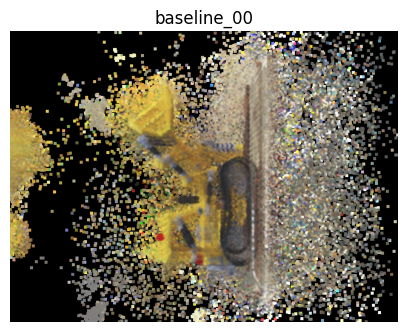

In [ ]:
renders = []
for i, (R, t) in enumerate(poses):
    im = render_points(R, t, K, H, W, data)
    out_path = os.path.join(OUTPUT_DIR, f"baseline_{i:02d}.png")
    imageio.imwrite(out_path, (im * 255).astype(np.uint8))
    renders.append(out_path)

print("Saved:", len(renders), "baseline images")

preview = np.asarray(Image.open(renders[0]).convert("RGB"))
plt.figure(figsize=(5,4)); plt.imshow(preview); plt.axis('off'); plt.title('baseline_00'); plt.show()

Saved: 12 baseline images


100%|██████████| 19/19 [02:09<00:00,  6.79s/it]


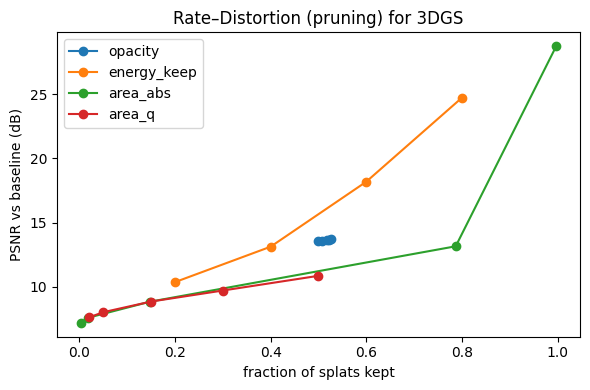

Saved: /content/PruneAndProve_results/rd_results.csv
           kind         val    kept  kept_frac  psnr_mean  \
9      area_abs   100000.00  384707   0.997317  28.725786   
8   energy_keep        0.80  308593   0.799998  24.713400   
7   energy_keep        0.60  231445   0.599999  18.183470   
0       opacity        0.02  202703   0.525489  13.692286   
1       opacity        0.05  201579   0.522575  13.672673   
2       opacity        0.10  199744   0.517818  13.643189   
3       opacity        0.20  196087   0.508337  13.602161   
4       opacity        0.30  192619   0.499347  13.547989   
10     area_abs  1000000.00  303617   0.787099  13.162099   
6   energy_keep        0.40  154296   0.399998  13.130496   
14       area_q  2183254.00  192871   0.500000  10.866074   
5   energy_keep        0.20   77148   0.199999  10.376183   

                      tag  
9    prune_area_abs_1e+05  
8   prune_energy_keep0.80  
7   prune_energy_keep0.60  
0      prune_opacity_0.02  
1      prune_

In [ ]:
def psnr(a, b):
    a = a.astype(np.float32) / 255.0
    b = b.astype(np.float32) / 255.0
    mse = np.mean((a - b) ** 2) + 1e-8
    return 20.0 * np.log10(1.0 / np.sqrt(mse))

def render_set(d, poses, K, H, W, tag):
    outs, imgs = [], []
    for i, (R, t) in enumerate(poses):
        im = render_points(R, t, K, H, W, d)
        p = os.path.join(OUTPUT_DIR, f"{tag}_{i:02d}.png")
        imageio.imwrite(p, (im * 255).astype(np.uint8))
        outs.append(p); imgs.append((im * 255).astype(np.uint8))
    return outs, imgs

def load_png(p):
    return np.asarray(Image.open(p).convert("RGB"))

baseline_paths, baseline_imgs = render_set(data, poses, K, H, W, "baseline")
print("Saved:", len(baseline_paths), "baseline images")

xyz = data['xyz'].numpy()
scales = data['scales'].numpy()
rot = data['rot'].numpy()
f_dc = data['f_dc'].numpy()
f_rest = None if data['f_rest'] is None else data['f_rest'].numpy()
opacity = data['opacity'].numpy()
N0 = xyz.shape[0]

def prune_opacity(thr):
    return opacity >= float(thr)

def sh_energy_per_splat(f_dc, f_rest):
    dc = 1/(1+np.exp(-f_dc))
    e_dc = np.mean(dc**2, axis=1)
    if f_rest is None or f_rest.size == 0:
        return e_dc
    rr = f_rest.reshape(f_rest.shape[0], -1, 3)
    rr = 1/(1+np.exp(-rr))
    e_rest = np.mean(rr**2, axis=(1,2))
    return e_dc + e_rest

def prune_low_energy(keep_frac):
    e = sh_energy_per_splat(f_dc, f_rest)
    k = max(1, int(len(e) * float(keep_frac)))
    thr = np.partition(e, -k)[-k]
    return e >= thr

def quat_to_mat(q):
    x, y, z, w = q.T
    t = 2.0 * np.array([x, y, z]).T
    xx, yy, zz = x*t[:,0], y*t[:,1], z*t[:,2]
    xy, xz, yz = x*t[:,1], x*t[:,2], y*t[:,2]
    wx, wy, wz = w*t[:,0], w*t[:,1], w*t[:,2]
    R = np.stack([
        1-(yy+zz), xy-wz,      xz+wy,
        xy+wz,      1-(xx+zz), yz-wx,
        xz-wy,      yz+wx,     1-(xx+yy)
    ], axis=1).reshape(-1,3,3)
    return R

def projected_area_avg(sample_poses=6):
    idxp = np.linspace(0, len(poses)-1, sample_poses, dtype=int)
    Rq = quat_to_mat(rot); s = scales; means = xyz
    A = np.zeros(len(means), dtype=np.float32)
    for j in idxp:
        Rv, tv = poses[j]
        Rp = Rq @ Rv.T
        z = (means @ Rv.T + tv)[:, 2]
        zsafe = z.copy(); zsafe[zsafe <= 1e-4] = 1e9
        sx = (Rp[:,0,:] * s).sum(1)
        sy = (Rp[:,1,:] * s).sum(1)
        ax = np.abs(sx) * K[0,0] / zsafe
        ay = np.abs(sy) * K[1,1] / zsafe
        A += (ax * ay).astype(np.float32)
    return A / max(1, len(idxp))

area_avg = projected_area_avg()
area_thresholds_abs = [1e5, 1e6, 1e7, 1e8, 1e9]
area_thresholds_q = list(np.quantile(area_avg, [0.5, 0.7, 0.85, 0.95, 0.98]))

def prune_area_abs(thr):
    return area_avg >= float(thr)

def prune_area_q(qthr):
    return area_avg >= float(qthr)

def apply_keep(mask):
    return {
        'xyz': data['xyz'][mask],
        'f_dc': data['f_dc'][mask],
        'f_rest': (None if data['f_rest'] is None else data['f_rest'][mask]),
        'scales': data['scales'][mask],
        'rot': data['rot'][mask],
        'opacity': data['opacity'][mask],
    }

experiments = []
experiments += [("opacity", x) for x in [0.02, 0.05, 0.10, 0.20, 0.30]]
experiments += [("energy_keep", x) for x in [0.20, 0.40, 0.60, 0.80]]
experiments += [("area_abs", x) for x in area_thresholds_abs]
experiments += [("area_q",   x) for x in area_thresholds_q]

results = []

for kind, val in tqdm(experiments):
    if kind == "opacity":
        keep = prune_opacity(val); tag = f"prune_opacity_{val}"
    elif kind == "energy_keep":
        keep = prune_low_energy(val); tag = f"prune_energy_keep{float(val):.2f}"
    elif kind == "area_abs":
        keep = prune_area_abs(val); tag = f"prune_area_abs_{float(val):.0e}"
    else:
        keep = prune_area_q(val);  tag = f"prune_area_q_{float(val):.2e}"

    nd = apply_keep(keep)
    _, imgs = render_set(nd, poses, K, H, W, tag)
    ps = [psnr(baseline_imgs[i], imgs[i]) for i in range(len(imgs))]
    results.append({
        'kind': kind,
        'val': float(val),
        'kept': int(keep.sum()),
        'kept_frac': float(keep.sum() / N0),
        'psnr_mean': float(np.mean(ps)),
        'tag': tag
    })

import pandas as pd
df = pd.DataFrame(results)
csv_path = os.path.join(OUTPUT_DIR, "rd_results.csv")
df.to_csv(csv_path, index=False)

plt.figure(figsize=(6,4))
for k in df['kind'].unique():
    sub = df[df['kind'] == k]
    plt.plot(sub['kept_frac'], sub['psnr_mean'], marker='o', label=k)
plt.xlabel('fraction of splats kept')
plt.ylabel('PSNR vs baseline (dB)')
plt.title('Rate–Distortion (pruning) for 3DGS')
plt.legend()
plt.tight_layout()
plt.savefig(os.path.join(OUTPUT_DIR, "rd_curve.png"), dpi=200)
plt.show()

print("Saved:", csv_path)
print(df.sort_values('psnr_mean', ascending=False).head(12))

In [ ]:
!pip -q install scikit-learn scipy
import scipy.sparse as sp
from sklearn.neighbors import NearestNeighbors

xyz_np = data['xyz'].numpy()
fdc_np = data['f_dc'].numpy()
frest_np = None if data['f_rest'] is None else data['f_rest'].numpy()
rot_np = data['rot'].numpy()
sc_np  = data['scales'].numpy()

def sh_energy_per_splat_np(f_dc, f_rest):
    dc = 1/(1+np.exp(-f_dc)); e_dc = np.mean(dc**2, axis=1)
    if f_rest is None or f_rest.size==0: return e_dc.astype(np.float32)
    rr = f_rest.reshape(f_rest.shape[0], -1, 3)
    rr = 1/(1+np.exp(-rr)); e_rest = np.mean(rr**2, axis=(1,2))
    return (e_dc + e_rest).astype(np.float32)

energy = sh_energy_per_splat_np(fdc_np, frest_np)

def quat_to_mat(q):
    x,y,z,w = q.T
    t = 2.0*np.array([x,y,z]).T
    xx,yy,zz = x*t[:,0], y*t[:,1], z*t[:,2]
    xy,xz,yz = x*t[:,1], x*t[:,2], y*t[:,2]
    wx,wy,wz = w*t[:,0], w*t[:,1], w*t[:,2]
    R = np.stack([
        1-(yy+zz), xy-wz,      xz+wy,
        xy+wz,      1-(xx+zz), yz-wx,
        xz-wy,      yz+wx,     1-(xx+yy)
    ], axis=1).reshape(-1,3,3)
    return R

Rq = quat_to_mat(rot_np)

def visibility_and_area(sample_poses=8):
    idxp = np.linspace(0, len(poses)-1, sample_poses, dtype=int)
    means = xyz_np; s = sc_np
    vis = np.zeros(len(means), dtype=np.int32)
    Aacc = np.zeros(len(means), dtype=np.float32)
    for j in idxp:
        Rv, tv = poses[j]
        Rp = Rq @ Rv.T
        X = means @ Rv.T + tv
        z = X[:,2]
        front = z > 1e-6
        if not np.any(front): continue
        x = X[front,0]/z[front]; y = X[front,1]/z[front]
        u = K[0,0]*x + K[0,2]; v = K[1,1]*y + K[1,2]
        inimg = (u>=0)&(u<W)&(v>=0)&(v<H)
        idx = np.where(front)[0][inimg]
        vis[idx] += 1

        sx = (Rp[:,0,:]*s).sum(1); sy = (Rp[:,1,:]*s).sum(1)
        zsafe = z.copy(); zsafe[zsafe<=1e-4] = 1e9
        ax = np.abs(sx)*K[0,0]/zsafe; ay = np.abs(sy)*K[1,1]/zsafe
        Aacc += (ax*ay).astype(np.float32)
    Aacc /= max(1, len(idxp))
    return vis, Aacc

vis_count, area_avg = visibility_and_area(sample_poses=8)
vis_rate = (vis_count / 8.0).astype(np.float32)

baseline_masks = []
for i in range(len(poses)):
    im = np.asarray(Image.open(os.path.join(OUTPUT_DIR, f"baseline_{i:02d}.png")).convert("RGB")).astype(np.float32)/255.0
    lum = 0.2126*im[...,0] + 0.7152*im[...,1] + 0.0722*im[...,2]
    baseline_masks.append((lum > 0.05))

def foreground_hit_rate(sample_poses=8):
    idxp = np.linspace(0, len(poses)-1, sample_poses, dtype=int)
    means = xyz_np; hits = np.zeros(len(means), dtype=np.int32)
    for j in idxp:
        Rv, tv = poses[j]
        X = means @ Rv.T + tv
        z = X[:,2]
        front = z > 1e-6
        if not np.any(front): continue
        x = X[front,0]/z[front]; y = X[front,1]/z[front]
        u = (K[0,0]*x + K[0,2]).round().astype(int)
        v = (K[1,1]*y + K[1,2]).round().astype(int)
        mask = (u>=0)&(u<W)&(v>=0)&(v<H)
        ii = np.where(front)[0][mask]
        uu = u[mask]; vv = v[mask]
        hit = baseline_masks[j][vv, uu]
        hits[ii] += hit.astype(np.int32)
    return (hits / max(1, len(idxp))).astype(np.float32)

fg_rate = foreground_hit_rate(sample_poses=8)

nbrs = NearestNeighbors(n_neighbors=16, algorithm='auto').fit(xyz_np)
dist, _ = nbrs.kneighbors(xyz_np, n_neighbors=16, return_distance=True)
local_density = 1.0 / (1e-6 + dist[:,1:16].mean(axis=1).astype(np.float32))

aux = {
    "energy": energy,
    "vis_rate": vis_rate,
    "area_avg": area_avg.astype(np.float32),
    "local_density": local_density,
    "fg_rate": fg_rate
}
print({k: (float(v.min()), float(np.median(v)), float(v.max())) for k,v in aux.items()})

{'energy': (0.25111323595046997, 0.48591363430023193, 1.2726505994796753), 'vis_rate': (0.0, 1.0, 1.0), 'area_avg': (8405.060546875, 2204038.75, 164296146944.0), 'local_density': (1.0235861539840698, 87.88699340820312, 1970.936767578125), 'fg_rate': (0.0, 1.0, 1.0)}


In [ ]:
def zscore(x):
    x = x.astype(np.float32)
    mu = np.median(x)
    sigma = np.median(np.abs(x - mu)) + 1e-6
    return (x - mu) / sigma

E = zscore(aux["energy"])
V = zscore(aux["vis_rate"])
A = zscore(aux["area_avg"])
D = zscore(aux["local_density"])
F = zscore(aux["fg_rate"])

A_clamped = np.clip(A, -2.0, 2.0)
wE, wV, wD, wF, wA = 0.4, 1.0, 1.2, 1.4, 0.2
importance = (wF*F) + (wV*V) + (wD*D) + (wE*E) - (wA*(-A_clamped))
importance = importance.astype(np.float32)

def keep_top_frac(frac):
    k = max(1, int(len(importance)*float(frac)))
    thr = np.partition(importance, -k)[-k]
    return importance >= thr

keep_fracs = [0.20, 0.30, 0.40, 0.60, 0.80]
results_hybrid = []

for f in keep_fracs:
    m = keep_top_frac(f)
    nd = {
        'xyz': data['xyz'][m],
        'f_dc': data['f_dc'][m],
        'f_rest': (None if data['f_rest'] is None else data['f_rest'][m]),
        'scales': data['scales'][m],
        'rot': data['rot'][m],
        'opacity': data['opacity'][m]
    }
    tag = f"hybrid_keep{f:.2f}"
    outs, imgs = [], []
    for i,(R,t) in enumerate(poses):
        im = render_points(R, t, K, H, W, nd)
        p = os.path.join(OUTPUT_DIR, f"{tag}_{i:02d}.png")
        imageio.imwrite(p, (im*255).astype(np.uint8))
        outs.append(p); imgs.append((im*255).astype(np.uint8))
    ps = [20*np.log10(255.0/np.sqrt(np.mean((imgs[i].astype(np.float32) - baseline_imgs[i].astype(np.float32))**2) + 1e-8)) for i in range(len(imgs))]
    results_hybrid.append((f, m.sum()/len(importance), float(np.mean(ps)), tag))

import pandas as pd
df_h = pd.DataFrame(results_hybrid, columns=["target_keep","actual_keep","psnr_mean","tag"])
print("Hybrid sweep:")
print(df_h.sort_values("psnr_mean", ascending=False))

best_row = df_h.sort_values("psnr_mean", ascending=False).iloc[0]
best_frac = float(best_row["target_keep"])
m = keep_top_frac(best_frac)

xyz_all = data['xyz'].numpy()
fg = aux["fg_rate"]
dens = aux["local_density"]
core_frac = 0.60
k_core = max(1, int(len(importance)*core_frac))
thr_core = np.partition(importance, -k_core)[-k_core]
core = importance >= thr_core
P = xyz_all[core]
pmin = np.percentile(P, 1.0, axis=0); pmax = np.percentile(P, 99.0, axis=0)
margin = 0.08
span = (pmax - pmin)
pmin_exp = pmin - margin*span
pmax_exp = pmax + margin*span
in_box = (xyz_all[:,0] >= pmin_exp[0]) & (xyz_all[:,0] <= pmax_exp[0]) & \
         (xyz_all[:,1] >= pmin_exp[1]) & (xyz_all[:,1] <= pmax_exp[1]) & \
         (xyz_all[:,2] >= pmin_exp[2]) & (xyz_all[:,2] <= pmax_exp[2])

fg_thr   = np.quantile(fg[core],   0.25)
dens_thr = np.quantile(dens[core], 0.15)
fg_keep   = fg   >= fg_thr
dens_keep = dens >= dens_thr

final_mask = m & in_box & fg_keep & dens_keep
print({"kept_hybrid": int(m.sum()), "kept_refined": int(final_mask.sum())})

nd_ref = {
    'xyz': data['xyz'][final_mask],
    'f_dc': data['f_dc'][final_mask],
    'f_rest': (None if data['f_rest'] is None else data['f_rest'][final_mask]),
    'scales': data['scales'][final_mask],
    'rot': data['rot'][final_mask],
    'opacity': data['opacity'][final_mask]
}
ref_tag = f"hybrid_refined_keep{best_frac:.2f}"
outs_r, imgs_r = [], []
for i,(R,t) in enumerate(poses):
    im = render_points(R, t, K, H, W, nd_ref)
    p = os.path.join(OUTPUT_DIR, f"{ref_tag}_{i:02d}.png")
    imageio.imwrite(p, (im*255).astype(np.uint8))
    outs_r.append(p); imgs_r.append((im*255).astype(np.uint8))

ps_ref = [20*np.log10(255.0/np.sqrt(np.mean((imgs_r[i].astype(np.float32) - baseline_imgs[i].astype(np.float32))**2)+1e-8)) for i in range(len(imgs_r))]
print(f"{ref_tag} mean PSNR vs baseline: {np.mean(ps_ref):.3f} dB")


Hybrid sweep:
   target_keep  actual_keep  psnr_mean              tag
4          0.8     0.799998  10.084110  hybrid_keep0.80
3          0.6     0.599999   8.405374  hybrid_keep0.60
2          0.4     0.399998   8.036628  hybrid_keep0.40
1          0.3     0.299998   7.864469  hybrid_keep0.30
0          0.2     0.199999   7.671397  hybrid_keep0.20
{'kept_hybrid': 308593, 'kept_refined': 203289}
hybrid_refined_keep0.80 mean PSNR vs baseline: 8.074 dB


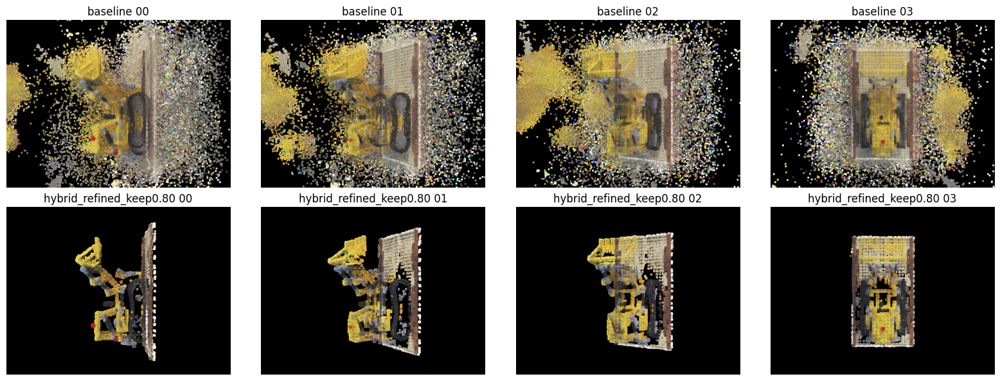

In [ ]:
ref_tag = ref_tag

cols = 4; rows = 2; idxs = list(range(min(cols, len(poses))))
plt.figure(figsize=(4*cols, 3*rows))
for i,k in enumerate(idxs):
    base = np.asarray(Image.open(os.path.join(OUTPUT_DIR, f"baseline_{k:02d}.png")).convert("RGB"))
    alt  = np.asarray(Image.open(os.path.join(OUTPUT_DIR, f"{ref_tag}_{k:02d}.png")).convert("RGB"))
    plt.subplot(rows, cols, i+1); plt.imshow(base); plt.axis('off'); plt.title(f"baseline {k:02d}")
    plt.subplot(rows, cols, i+1+cols); plt.imshow(alt); plt.axis('off'); plt.title(f"{ref_tag} {k:02d}")
plt.tight_layout(); plt.show()

In [ ]:
best_tag = df_h.sort_values("psnr_mean", ascending=False).iloc[0]["tag"]
keep_frac = float(best_tag.split("hybrid_keep")[-1])
k = max(1, int(len(importance) * keep_frac))
thr = np.partition(importance, -k)[-k]
mask = (importance >= thr)
xyz_np = data['xyz'].numpy()[mask]
fdc_np = data['f_dc'].numpy()[mask]
rgb = 1.0 / (1.0 + np.exp(-fdc_np))
n = xyz_np.shape[0]
take = min(200_000, n)
idx = np.random.choice(n, size=take, replace=False) if n > take else np.arange(n)
px = xyz_np[idx]
pc = rgb[idx]

import plotly.graph_objects as go

fig = go.Figure(
    data=[go.Scatter3d(
        x=px[:, 0], y=px[:, 1], z=px[:, 2],
        mode='markers',
        marker=dict(size=1, color=pc, opacity=0.85)
    )]
)
fig.update_layout(
    scene=dict(xaxis=dict(visible=False),
               yaxis=dict(visible=False),
               zaxis=dict(visible=False)),
    margin=dict(l=0, r=0, b=0, t=30),
    title=f"{best_tag} — kept {mask.sum()} / {len(importance)} ({mask.mean():.2%})"
)
fig.show()